In [1]:
# system
import glob, pickle, multiprocessing
from joblib import Parallel, delayed
from pathlib import Path

# pyscience imports
import numpy as np
import pandas as pd

# viz
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from plotnine import *
sns.set(style="ticks", context="talk")
font = {'family' : 'IBM Plex Sans',
               'weight' : 'normal',
               'size'   : 10}
plt.rc('font', **font)
plt.rcParams['figure.figsize'] = (10, 10)
matplotlib.style.use(['seaborn-talk', 'seaborn-ticks', 'seaborn-whitegrid'])
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# geodata packages
import geopandas as gpd
import contextily as cx

/home/alal/anaconda3/envs/gds/lib/python3.7/site-packages/geopandas/_compat.py:110: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


# Data Ingest

downloaded by `0_get` from [this excellent repository](https://cdmaps.polisci.ucla.edu/). State-specific zipfiles can be found [here](https://github.com/JeffreyBLewis/congressional-district-boundaries).

## one-time read and pickle of all geometries

In [2]:
shapes1 = sorted(glob.glob("shp/*.zip"))
shapes1[:5]

['shp/districts001.zip',
 'shp/districts002.zip',
 'shp/districts003.zip',
 'shp/districts004.zip',
 'shp/districts005.zip']

Geopandas can read zipfiles, which saves us the trouble of having to unzip everything. Marginally slower, so extract if you plan to read files repeatedly. I parallelise the reading in process across 4 cores.

In [7]:
%%time
readCong = lambda x: gpd.read_file(f"zip://{x}!districtShapes")['geometry']
cong_files = Parallel(n_jobs=6)(delayed(readCong)(f) for f in shapes1)

CPU times: user 1min 34s, sys: 9.22 s, total: 1min 43s
Wall time: 1min 49s


In [8]:
cong_files[0].shape

(51,)

<AxesSubplot:>

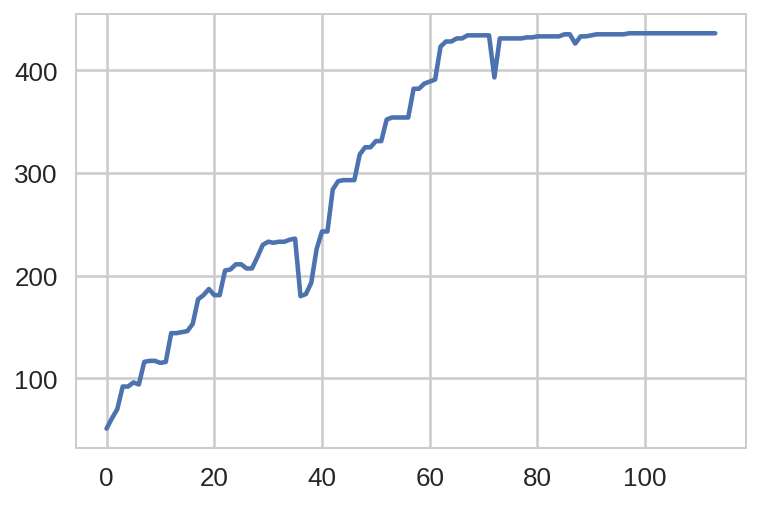

In [9]:
pd.Series([f.shape[0] for f in cong_files]).plot()

In [11]:
%%time
import pickle
with open("tmp/list_of_maps.pkl", "wb") as f:
    pickle.dump(cong_files, f)

CPU times: user 33.7 s, sys: 3.02 s, total: 36.7 s
Wall time: 36.7 s


## read pickled lists

In [2]:
%%time
cong_files =  pickle.load(open("tmp/list_of_maps.pkl", "rb"))

CPU times: user 46.4 s, sys: 3.76 s, total: 50.2 s
Wall time: 51 s


In [3]:
xw = pd.read_pickle("tmp/cong_time_xw.pkl")
xw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 116 entries, 0 to 115
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   cong       116 non-null    int64         
 1   startdate  116 non-null    datetime64[ns]
 2   enddate    116 non-null    datetime64[ns]
dtypes: datetime64[ns](2), int64(1)
memory usage: 2.8 KB


## dry run

In [4]:
us_outline = gpd.read_file("https://www2.census.gov/geo/tiger/TIGER2017//STATE/tl_2017_us_state.zip")

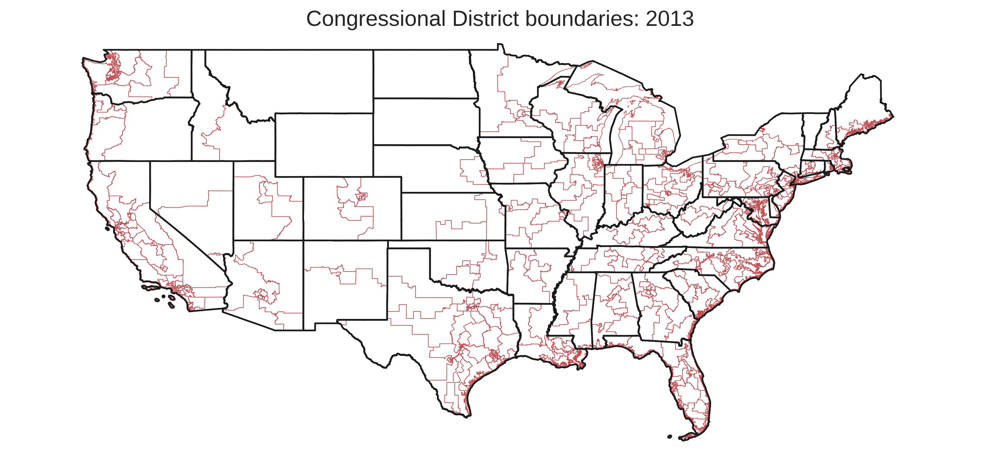

In [5]:
f, ax = plt.subplots(figsize = (10, 12), dpi = 150)
k = 113
cong_files[k].plot(facecolor = 'None', edgecolor = 'r', ax = ax)
ax.set_ylim(24, 50)
ax.set_xlim(-130, -60)
us_outline.plot(facecolor = 'None', edgecolor = 'k', linewidth = 1.2, ax = ax)
ax.set_axis_off()
ax.set_title(f"Congressional District boundaries: {xw.loc[xw.cong == k]['startdate'].dt.year.values[0]}")
f.tight_layout()

# Animated map

In [6]:
from matplotlib import animation
from IPython.display import display
from IPython.display import HTML

In [16]:
def plot_animation(list_dfs = cong_files):
    f, ax = plt.subplots(figsize = (15, 10), dpi = 120)

    def get_data(i):
        data = list_dfs[i]
        return(data)

    def animate(k):
        ax.clear()
        # extract data
        data = get_data(k)
        # plot CDs
        data.plot(facecolor = 'None', edgecolor = 'r', ax = ax)
        # outline
        us_outline.plot(facecolor = 'None', edgecolor = 'k', linewidth = 1.2, ax = ax)
        ax.set_title(f"US Congressional District boundaries \n {xw.loc[xw.cong == k+1]['startdate'].dt.year.values[0]}")
        # zoom in on mainland
        ax.set_ylim(24, 50)
        ax.set_xlim(-130, -60)
        ax.set_axis_off()

    ani = animation.FuncAnimation(
            f, animate, frames=list(range(0,len(list_dfs))), interval=400,
            repeat=True, blit=False
        )
    f.tight_layout()
    return ani

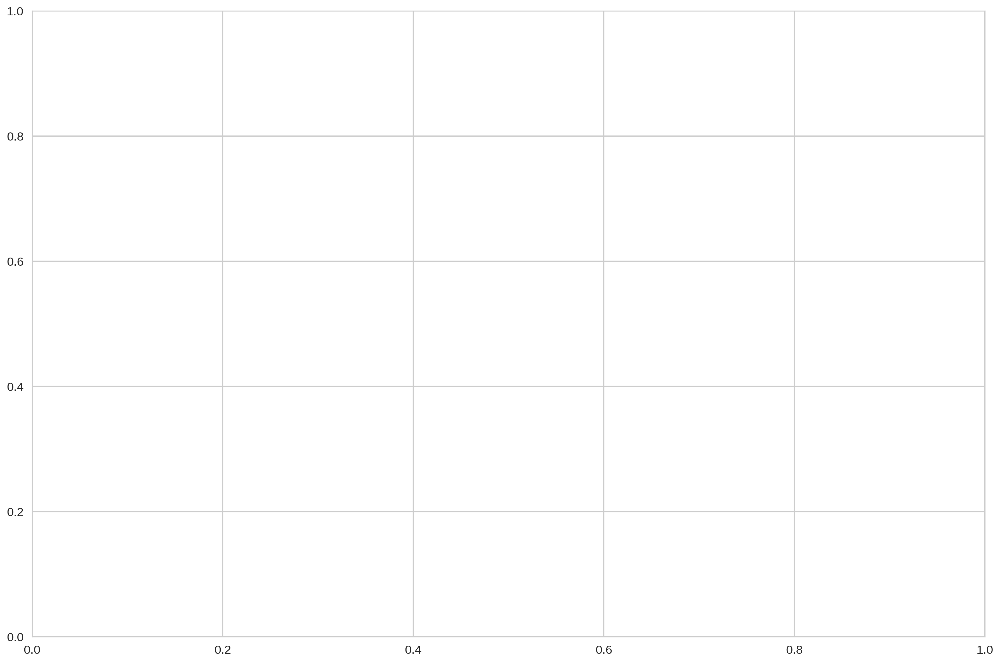

In [17]:
ani = plot_animation()

Write to mp4. Output omitted.

In [ ]:
%%time
HTML(ani.to_html5_video())

Convert to interactive animation

In [18]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

## Interactive

In [19]:
HTML(ani.to_jshtml())

<Figure size 432x288 with 0 Axes>